In [1]:
from typing import List, Tuple, Union

import numpy as np
import matplotlib as mpl
from PIL import Image, ImageDraw
from matplotlib import pyplot as plt
from matplotlib.pyplot import colormaps

from ee23b035_draw import draw_keyboard
from ee23b035_keyboard import REQUIRED_NORMAL_KEYS, REQUIRED_SPECIAL_KEYS

from ee23b035_config import KB_LAYOUT, HOME_ROW_POS, KB_NAME
from ee23b035_config import KB_W, KB_H, G_WIDTH, K_PRESS_HMAP_W, CMAP

from ee23b035_utils import Position
from ee23b035_utils import find_key_name, get_key_position
from ee23b035_utils import generate_kb_rows, euclidean_dist

In [13]:
IGNORE_SPACES = True

In [24]:
text = """
Don't let good saying void fowl replenish subdue day sixth herb brought him set open ear open I do.
"""

In [25]:
def type_key(char: str) -> Tuple[List[str], float]:
    """
    Calculate travel distance involved in typing a character.

    Args:
        char (str): Character to be type

    Returns:
        List[str]: List of key names to be pressed
        float: Total travel distance involved
    """

    # Map special characters to the key names
    special_chars = {" ": "Space", "\n": "Enter", "\t": "Tab", "\b": "Backspace"}
    # If the given char is a special char, update the name
    char = special_chars.get(char, char)

    pos, USE_SHIFT = get_key_position(char, KB_LAYOUT)
    KEY_LEFT = True  # Indicate which side of the keyboard the key is on

    # We have to press the key containing char
    to_press = [find_key_name(char, KB_LAYOUT)]

    # Calculate the fastest way to type the key:
    min_dist = euclidean_dist(HOME_ROW_POS[0], pos)
    for idx, neutral_pos in enumerate(HOME_ROW_POS):
        dist = euclidean_dist(neutral_pos, pos)
        if dist < min_dist:
            min_dist = dist
            # idx < 4 -> key would be typed with left hand
            # idx >= 4 -> key would be typed with right hand
            KEY_LEFT = idx < 4

    # Account for distance to travel to shift key
    if USE_SHIFT:
        if KEY_LEFT:
            # If key is on left, type shift with right hand
            shift_key = get_key_position("Shift_R", KB_LAYOUT)[0]
            min_dist += euclidean_dist(get_key_position(";", KB_LAYOUT)[0], shift_key)
            to_press.append("Shift_R") # Also press shift
        else:
            # If key is on right, type shift with left hand
            shift_key = get_key_position("Shift_L", KB_LAYOUT)[0]
            min_dist += euclidean_dist(get_key_position("a", KB_LAYOUT)[0], shift_key)
            to_press.append("Shift_L") # Also press shift

    return to_press, min_dist



In [26]:
# Generate keyboard image
image = Image.new("RGB", (KB_W, KB_H), (100, 100, 100))
painter = ImageDraw.Draw(image)
key_center_map = draw_keyboard(generate_kb_rows(KB_LAYOUT), painter)

Text(0.5, 1.0, 'Keyboard: QWERTY\nTravel Distance: 331.812')

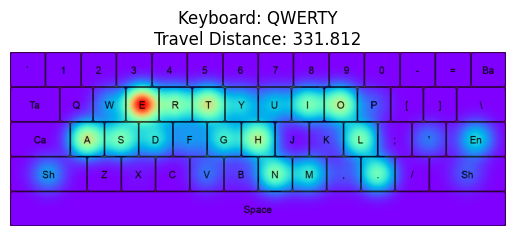

In [27]:
fig, ax = plt.subplots()
plt.axis("off")
ims = []

# Generate heat_map matrix
# Dimensions: KB_H + K_PRESS_HMAP_W, KB_W + K_PRESS_HMAP_W
# We will trim off the K_PRESS_HMAP_W later
# This extra width and length is added so that the full
# key_press matrix can always fit inside the heat_map matrix
heat_map = np.zeros((KB_H + K_PRESS_HMAP_W, KB_W + K_PRESS_HMAP_W))

# Generate key press gaussian
# This will be superimposed on heat_map whenever a key is pressed
x, y = np.meshgrid(
    np.linspace(-G_WIDTH, G_WIDTH, K_PRESS_HMAP_W),
    np.linspace(-G_WIDTH, G_WIDTH, K_PRESS_HMAP_W),
)
r_sq = x**2 + y**2
key_press_matrix = np.exp(-r_sq / 2) / (2 * 3.14159)

if IGNORE_SPACES:
    text = text.replace(" ", "")

# Key press frequency mapping
key_freq = {key: 0 for key in REQUIRED_NORMAL_KEYS | REQUIRED_SPECIAL_KEYS}
travel_dist = 0

# Trim the extra padding
trimmed_heat_map = heat_map[
    K_PRESS_HMAP_W // 2 : -K_PRESS_HMAP_W // 2,
    K_PRESS_HMAP_W // 2 : -K_PRESS_HMAP_W // 2,
]
trimmed_heat_map = CMAP(trimmed_heat_map)[:, :, :3] * 255  # CMAP returns RGBA, we don't want the A

# PIL.Image to np.array (so we can do a superpose later on)
img_array = np.array(image)

empty_img_fig = ax.imshow(trimmed_heat_map.astype(np.uint8) & img_array)
empty_img_fig.axes.get_xaxis().set_visible(False)
empty_img_fig.axes.get_yaxis().set_visible(False)

plt.title(f"Keyboard: {KB_NAME}\nTravel Distance: {travel_dist:.3f}")
ims.append([empty_img_fig])

# Iteratively calculate travel distance
travel_dist = 0
for char in text:
    to_press, dist = type_key(char)
    travel_dist += dist

    # Update the heat map
    for key_to_press in to_press:
        key_freq[key_to_press] += 1

        x, y = key_center_map[key_to_press]
        x, y = int(x), int(y)
        heat_map[y : y + K_PRESS_HMAP_W, x : x + K_PRESS_HMAP_W] += key_press_matrix


    # Trim the extra padding
    trimmed_heat_map = heat_map[
        K_PRESS_HMAP_W // 2 : -K_PRESS_HMAP_W // 2,
        K_PRESS_HMAP_W // 2 : -K_PRESS_HMAP_W // 2,
    ]
    # Normalise from 0 - 1
    trimmed_heat_map -= trimmed_heat_map.min()
    trimmed_heat_map /= trimmed_heat_map.max()
    trimmed_heat_map = CMAP(trimmed_heat_map)[:, :, :3] * 255  # CMAP returns RGBA, we don't want the A
    
    # Superimpose heatmap on top of keyboard
    combined_img = img_array & trimmed_heat_map.astype(np.uint8)
    
    # Show image
    img_fig = ax.imshow(combined_img, vmin=min(key_freq.values()), vmax=max(key_freq.values()))
    
    img_fig.axes.get_xaxis().set_visible(False)
    img_fig.axes.get_yaxis().set_visible(False)
    
    ims.append([img_fig])

plt.title(f"Keyboard: {KB_NAME}\nTravel Distance: {travel_dist:.3f}")

In [28]:
from matplotlib.animation import ArtistAnimation
from IPython.display import HTML

ani = ArtistAnimation(fig, ims, interval=100, repeat=True)
HTML(ani.to_jshtml())

In [19]:
print("Total Travel Distance:", travel_dist)

# Display key press frequency
print("Key Press Frequency:")

counter = 1
for key in sorted(REQUIRED_NORMAL_KEYS):
    freq = key_freq[key]
    if counter % 10 != 0:
        print(f"{key} {freq}", end="\t")
    else:
        print(f"{key} {freq}")
    counter += 1

print()

# Special keys at the end
for key in sorted(REQUIRED_SPECIAL_KEYS):
    print(f"{key}: {key_freq[key]}")

Total Travel Distance: 331.8116523035733
Key Press Frequency:
' 2	, 1	- 0	. 6	/ 0	0 0	1 0	2 0	3 0	4 0
5 0	6 0	7 0	8 0	9 0	; 0	= 0	[ 0	\ 0	] 0
` 0	a 10	b 3	c 0	d 9	e 18	f 4	g 6	h 13	i 9
j 0	k 1	l 7	m 5	n 10	o 15	p 3	q 0	r 10	s 9
t 12	u 6	v 3	w 3	x 1	y 5	z 0	
Backspace: 0
CapsLock: 0
Enter: 5
Shift_L: 3
Shift_R: 3
Space: 0
Tab: 0
